## About Dataset
#### Abstract
The data is related to direct marketing campaigns (phone calls) of a Portuguese banking institution. The classification goal is to predict if the client will subscribe a term deposit (variable y).

#### Information
The data is related to direct marketing campaign direct marketing campaigns of a Portuguese banking institution. The marketing campaigns were based on phone calls. Often, more than one contact to the same client was required, in order to access if the product (bank term deposit) would be ('yes') or not ('no') subscribed.
bank-additional-full.csv with all examples (41188) and 20 inputs, ordered by date (from May 2008 to November 2010), very close to the data analyzed in [Moro et al., 2014]
The smallest datasets are provided to test more computationally demanding machine learning algorithms (e.g., SVM). The classification goal is to predict if the client will subscribe (yes/no) a term deposit (variable y).

#### Attributes
##### Input variables:

##### bank client data:
1 - age (numeric)
2 - job : type of job (categorical: 'admin.','blue-collar','entrepreneur','housemaid','management','retired','self-employed','services','student','technician','unemployed','unknown')
3 - marital : marital status (categorical: 'divorced','married','single','unknown'; note: 'divorced' means divorced or widowed)
4 - education (categorical: 'basic.4y','basic.6y','basic.9y','high.school','illiterate','professional.course','university.degree','unknown')
5 - default: has credit in default? (categorical: 'no','yes','unknown')
6 - housing: has housing loan? (categorical: 'no','yes','unknown')
7 - loan: has personal loan? (categorical: 'no','yes','unknown')

##### related with the last contact of the current campaign:
8 - contact: contact communication type (categorical: 'cellular','telephone')
9 - month: last contact month of year (categorical: 'jan', 'feb', 'mar', …, 'nov', 'dec')
10 - day_of_week: last contact day of the week (categorical: 'mon','tue','wed','thu','fri')
11 - duration: last contact duration, in seconds (numeric). Important note: this attribute highly affects the output target (e.g., if duration=0 then y='no'). Yet, the duration is not known before a call is performed. Also, after the end of the call y is obviously known. Thus, this input should only be included for benchmark purposes and should be discarded if the intention is to have a realistic predictive model.

##### other attributes:
12 - campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)
13 - pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric; 999 means client was not previously contacted)
14 - previous: number of contacts performed before this campaign and for this client (numeric)
15 - poutcome: outcome of the previous marketing campaign (categorical: 'failure','nonexistent','success')

##### social and economic context attributes
16 - emp.var.rate: employment variation rate - quarterly indicator (numeric)
17 - cons.price.idx: consumer price index - monthly indicator (numeric)
18 - cons.conf.idx: consumer confidence index - monthly indicator (numeric)
19 - euribor3m: euribor 3 month rate - daily indicator (numeric)
20 - nr.employed: number of employees - quarterly indicator (numeric)

##### Output variable (desired target):
21 - y - has the client subscribed a term deposit? (binary: 'yes','no')

In [14]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)

In [171]:
from imblearn.over_sampling import ADASYN

In [128]:
from sklearn.preprocessing import LabelEncoder

In [134]:
from sklearn.model_selection import train_test_split

In [135]:
from sklearn.preprocessing import StandardScaler

In [146]:
import statsmodels.api as sma

In [166]:
from sklearn.metrics import roc_auc_score,roc_curve

In [163]:
from sklearn.metrics import confusion_matrix,accuracy_score,precision_score,recall_score,f1_score,cohen_kappa_score,classification_report


In [3]:
data=pd.read_csv('bank-additional-full.csv',sep=';',na_values='unknown')
data.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,NaN,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [4]:
data.columns

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'emp.var.rate', 'cons.price.idx',
       'cons.conf.idx', 'euribor3m', 'nr.employed', 'y'],
      dtype='object')

## 1. Basic Exploration:

In [6]:
print('Observations:',data.shape[0])
print('Variables:',data.shape[1])

Observations: 41188
Variables: 21


In [7]:
data.isnull().sum()

age                  0
job                330
marital             80
education         1731
default           8597
housing            990
loan               990
contact              0
month                0
day_of_week          0
duration             0
campaign             0
pdays                0
previous             0
poutcome             0
emp.var.rate         0
cons.price.idx       0
cons.conf.idx        0
euribor3m            0
nr.employed          0
y                    0
dtype: int64

In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             40858 non-null  object 
 2   marital         41108 non-null  object 
 3   education       39457 non-null  object 
 4   default         32591 non-null  object 
 5   housing         40198 non-null  object 
 6   loan            40198 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

In [9]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
age,41188.0,40.024060,10.421250,17.000,32.000,38.000,47.000,98.000
duration,41188.0,258.285010,259.279249,0.000,102.000,180.000,319.000,4918.000
campaign,41188.0,2.567593,2.770014,1.000,1.000,2.000,3.000,56.000
pdays,41188.0,962.475454,186.910907,0.000,999.000,999.000,999.000,999.000
previous,41188.0,0.172963,0.494901,0.000,0.000,0.000,0.000,7.000
emp.var.rate,41188.0,0.081886,1.570960,-3.400,-1.800,1.100,1.400,1.400
cons.price.idx,41188.0,93.575664,0.578840,92.201,93.075,93.749,93.994,94.767
cons.conf.idx,41188.0,-40.502600,4.628198,-50.800,-42.700,-41.800,-36.400,-26.900
euribor3m,41188.0,3.621291,1.734447,0.634,1.344,4.857,4.961,5.045
nr.employed,41188.0,5167.035911,72.251528,4963.600,5099.100,5191.000,5228.100,5228.100


In [11]:
data.describe(include='object').T

,count,unique,top,freq
job,40858,11,admin.,10422
marital,41108,3,married,24928
education,39457,7,university.degree,12168
default,32591,2,no,32588
housing,40198,2,yes,21576
loan,40198,2,no,33950
contact,41188,2,cellular,26144
month,41188,10,may,13769
day_of_week,41188,5,thu,8623
poutcome,41188,3,nonexistent,35563


## 2. Univariate and Bivariate Analysis:

In [15]:
data.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,261,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,NaN,no,no,telephone,may,mon,149,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,226,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,151,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,307,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [16]:
num_cols=['age','duration','campaign','emp.var.rate','cons.price.idx','cons.conf.idx','euribor3m','nr.employed']

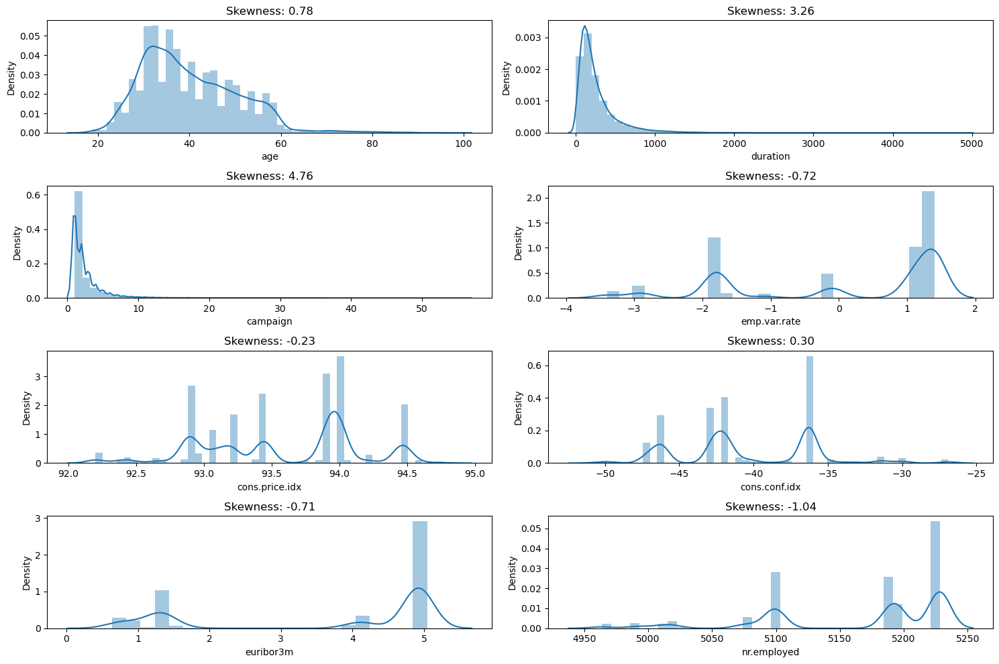

In [18]:
t=1
plt.figure(figsize=(15,10))
for i in num_cols:
    plt.subplot(4,2,t)
    sns.distplot(data[i])
    plt.title('Skewness: %.2f'%data[i].skew())
    t+=1
plt.tight_layout()
plt.show()

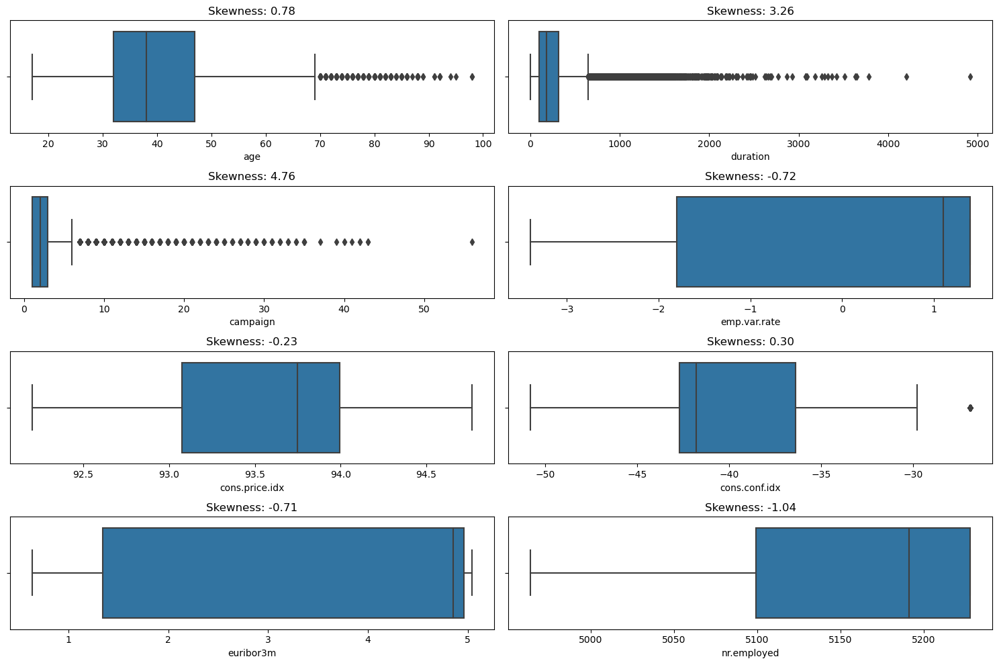

In [20]:
t=1
plt.figure(figsize=(15,10))
for i in num_cols:
    plt.subplot(4,2,t)
    sns.boxplot(data[i])
    plt.title('Skewness: %.2f'%data[i].skew())
    t+=1
plt.tight_layout()
plt.show()

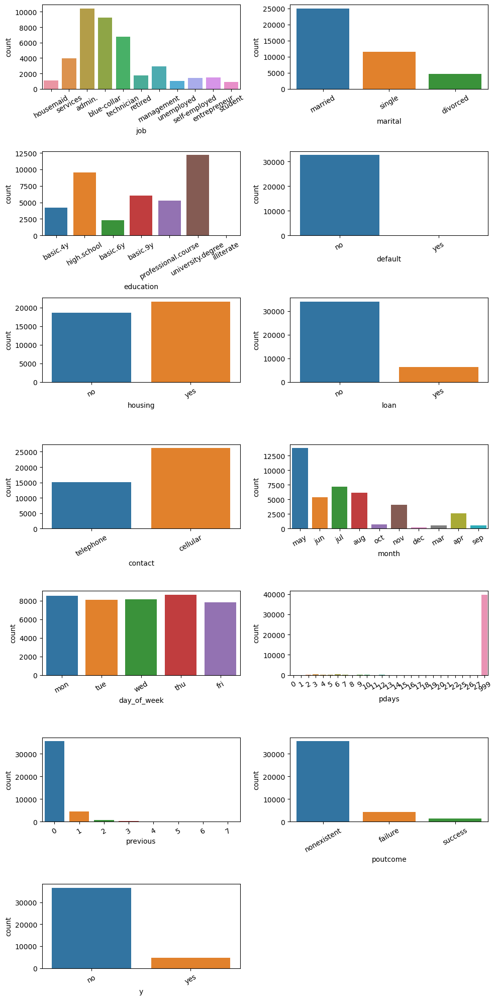

In [27]:
t=1
plt.figure(figsize=(10,20))
for i in data.drop(num_cols,axis=1).columns:
    plt.subplot(7,2,t)
    sns.countplot(data[i])
    plt.xticks(rotation=30)
    t+=1
plt.tight_layout()
plt.show()

### Correct the features in the dataset:

In [29]:
data.pdays=data.pdays.map(lambda x: 1 if x<999 else 0)

In [32]:
data.previous=data.previous.map(lambda x: 0 if x==0 else 1)

In [34]:
data.drop(columns='duration',inplace=True)

In [35]:
data.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,NaN,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


## 3. Missing Values Treatment:

In [36]:
data.isnull().sum()

age                  0
job                330
marital             80
education         1731
default           8597
housing            990
loan               990
contact              0
month                0
day_of_week          0
campaign             0
pdays                0
previous             0
poutcome             0
emp.var.rate         0
cons.price.idx       0
cons.conf.idx        0
euribor3m            0
nr.employed          0
y                    0
dtype: int64

In [37]:
data[data.marital.isnull()]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
40,58,management,NaN,university.degree,no,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
390,59,retired,NaN,university.degree,NaN,no,no,telephone,may,tue,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
413,57,retired,NaN,basic.4y,no,no,no,telephone,may,tue,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1493,33,services,NaN,high.school,no,yes,yes,telephone,may,thu,2,0,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
1608,32,NaN,NaN,university.degree,no,no,no,telephone,may,fri,4,0,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,yes
3167,57,retired,NaN,basic.4y,no,yes,no,telephone,may,thu,10,0,0,nonexistent,1.1,93.994,-36.4,4.860,5191.0,no
3478,37,management,NaN,high.school,no,no,no,telephone,may,thu,6,0,0,nonexistent,1.1,93.994,-36.4,4.860,5191.0,no
4196,31,admin.,NaN,high.school,no,no,no,telephone,may,mon,8,0,0,nonexistent,1.1,93.994,-36.4,4.858,5191.0,no
4344,32,NaN,NaN,university.degree,no,yes,yes,telephone,may,tue,1,0,0,nonexistent,1.1,93.994,-36.4,4.856,5191.0,no
4454,31,blue-collar,NaN,NaN,NaN,no,no,telephone,may,tue,2,0,0,nonexistent,1.1,93.994,-36.4,4.856,5191.0,no


In [42]:
data.groupby('marital')['age'].mean()

marital
divorced    44.899393
married     42.307165
single      33.158714
Name: age, dtype: float64

In [43]:
data[data.age<=30]['marital'].mode()

0    single
Name: marital, dtype: object

In [45]:
data[(data.age>30) & (data.age<=60)]['marital'].mode()

0    married
Name: marital, dtype: object

In [46]:
data[data.age>60]['marital'].mode()

0    married
Name: marital, dtype: object

In [47]:
data.marital=np.where((data['marital'].isnull()) & (data.age<=30),'single',data.marital)

In [48]:
data.marital=np.where((data['marital'].isnull()) & (data.age>30),'married',data.marital)

<AxesSubplot:>

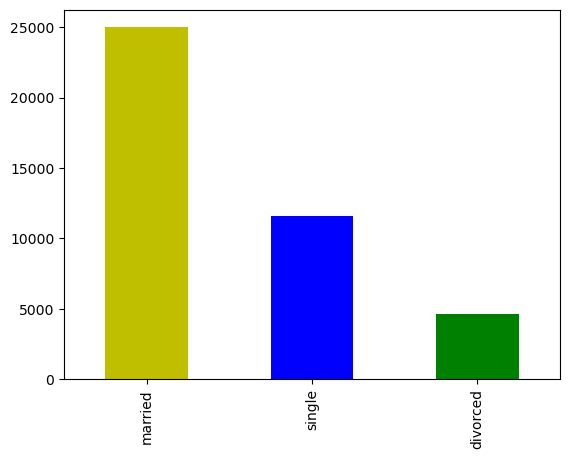

In [54]:
data.marital.value_counts().plot(kind='bar',color=['y','b','g'])

In [63]:
drop_index=data[(data.job.isnull()) & (data.education.isnull())].index

In [64]:
data.drop(index=drop_index,inplace=True)

In [65]:
data[data.job.isnull()]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
29,55,NaN,married,university.degree,NaN,NaN,NaN,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
35,55,NaN,married,basic.4y,NaN,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
144,38,NaN,divorced,high.school,NaN,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
794,28,NaN,single,basic.9y,NaN,no,no,telephone,may,wed,1,0,0,nonexistent,1.1,93.994,-36.4,4.856,5191.0,no
878,28,NaN,single,basic.9y,NaN,yes,no,telephone,may,wed,2,0,0,nonexistent,1.1,93.994,-36.4,4.856,5191.0,no
885,43,NaN,married,high.school,NaN,no,no,telephone,may,wed,1,0,0,nonexistent,1.1,93.994,-36.4,4.856,5191.0,no
1131,43,NaN,married,high.school,NaN,no,no,telephone,may,wed,3,0,0,nonexistent,1.1,93.994,-36.4,4.856,5191.0,no
1165,52,NaN,married,basic.4y,no,no,no,telephone,may,thu,1,0,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
1181,44,NaN,married,basic.6y,no,no,no,telephone,may,thu,1,0,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no
1205,35,NaN,married,basic.9y,no,yes,yes,telephone,may,thu,1,0,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no


In [69]:
data[data.education.isnull()]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
7,41,blue-collar,married,NaN,NaN,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
10,41,blue-collar,married,NaN,NaN,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
26,59,technician,married,NaN,no,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
30,46,admin.,married,NaN,no,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
31,59,technician,married,NaN,no,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
32,49,blue-collar,married,NaN,no,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
67,33,admin.,married,NaN,no,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
78,55,management,married,NaN,NaN,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
92,60,admin.,married,NaN,NaN,no,yes,telephone,may,mon,2,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
100,54,services,married,NaN,no,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [77]:
uniq_jobs=data[data.education.isnull()]['job'].unique()

In [79]:
for i in uniq_jobs:
    mod=data[data.job==i]['education'].mode()[0]
    data.education=np.where((data.education.isnull())&(data.job==i),mod,data.education)

<AxesSubplot:>

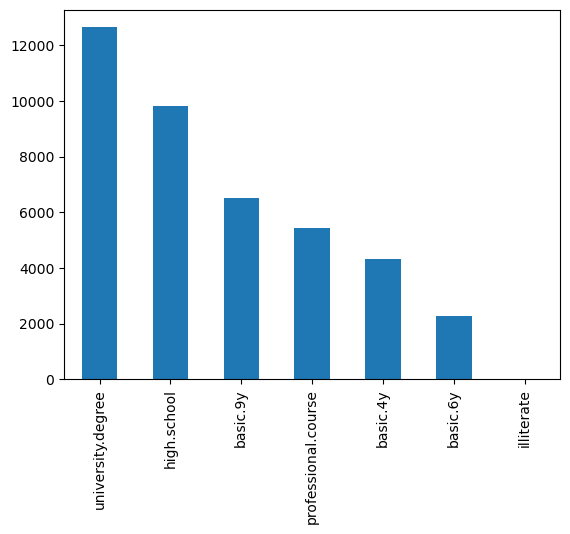

In [81]:
data.education.value_counts().plot(kind='bar')

In [82]:
uniq_edu=data[data.job.isnull()]['education'].unique()

In [83]:
for i in uniq_edu:
    mod=data[data.education==i]['job'].mode()[0]
    data.job=np.where((data.job.isnull())&(data.education==i),mod,data.job)

<AxesSubplot:>

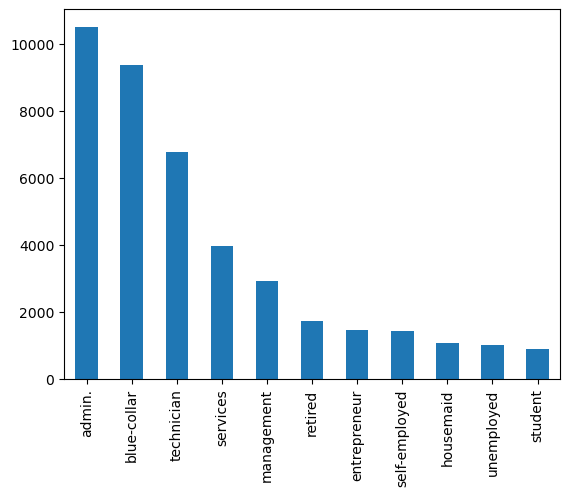

In [84]:
data.job.value_counts().plot(kind='bar')

In [87]:
len(data[(data.housing.isnull()) & (data.loan.isnull())])

988

In [88]:
data.isnull().sum()

age                  0
job                  0
marital              0
education            0
default           8523
housing            988
loan               988
contact              0
month                0
day_of_week          0
campaign             0
pdays                0
previous             0
poutcome             0
emp.var.rate         0
cons.price.idx       0
cons.conf.idx        0
euribor3m            0
nr.employed          0
y                    0
dtype: int64

In [89]:
data.drop(index=data[data.loan.isnull()].index,inplace=True)

In [90]:
data.shape

(40069, 20)

In [91]:
data[data.default.isnull()]

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
1,57,services,married,high.school,NaN,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
5,45,services,married,basic.9y,NaN,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
7,41,blue-collar,married,basic.9y,NaN,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
10,41,blue-collar,married,basic.9y,NaN,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
15,54,retired,married,basic.9y,NaN,yes,yes,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
17,46,blue-collar,married,basic.6y,NaN,yes,yes,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
19,39,management,single,basic.9y,NaN,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
21,55,blue-collar,married,basic.4y,NaN,yes,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
27,39,self-employed,married,basic.9y,NaN,no,no,telephone,may,mon,1,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
28,54,technician,single,university.degree,NaN,no,no,telephone,may,mon,2,0,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [92]:
data.default.value_counts()

no     31768
yes        3
Name: default, dtype: int64

In [93]:
len(data[(data.loan=='no')&(data.housing=='no')&(data.default.isnull())])

3432

In [100]:
data.default=np.where(data.default.isnull(),'unknown',data.default)

In [101]:
data.default.isnull().sum()

0

In [102]:
data.default.value_counts()

no         31768
unknown     8298
yes            3
Name: default, dtype: int64

## 4. Outlier treatment:

In [103]:
q1,q3=np.quantile(data.campaign,[0.25,0.75])
IQR=q3-q1
upper=q3+1.5*IQR
lower=q1-1.5*IQR
data.campaign=np.where(data.campaign>upper,upper,data.campaign)
data.campaign=np.where(data.campaign<lower,lower,data.campaign)

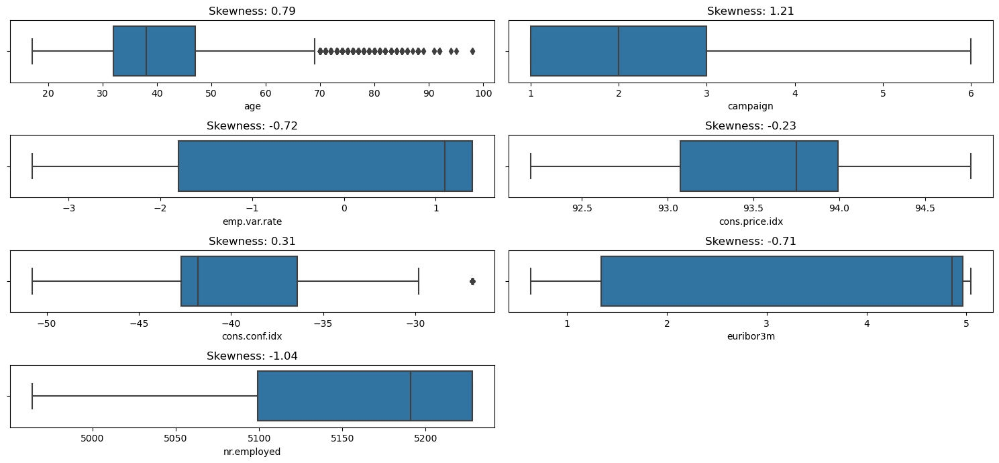

In [105]:
t=1
plt.figure(figsize=(15,10))
for i in num_cols:
    if i != 'duration':
        plt.subplot(6,2,t)
        sns.boxplot(data[i])
        plt.title('Skewness: %.2f'%data[i].skew())
        t+=1
plt.tight_layout()
plt.show()

In [107]:
data.job.value_counts()

admin.           10275
blue-collar       9118
technician        6608
services          3868
management        2853
retired           1676
entrepreneur      1420
self-employed     1381
housemaid         1031
unemployed         987
student            852
Name: job, dtype: int64

In [108]:
data.marital.value_counts()

married     24295
single      11288
divorced     4486
Name: marital, dtype: int64

In [109]:
data.education.value_counts()

university.degree      12360
high.school             9605
basic.9y                6337
professional.course     5323
basic.4y                4194
basic.6y                2232
illiterate                18
Name: education, dtype: int64

In [111]:
#Frequency Encoding on job:
map_jobs=data.job.value_counts(normalize=True)
data.job=data.job.map(map_jobs)

In [112]:
data.month.unique()

array(['may', 'jun', 'jul', 'aug', 'oct', 'nov', 'dec', 'mar', 'apr',
       'sep'], dtype=object)

In [113]:
data.day_of_week.unique()

array(['mon', 'tue', 'wed', 'thu', 'fri'], dtype=object)

In [114]:
#Frequency Encoding on month & day_of_week:
map_month=data.month.value_counts(normalize=True)
data.month=data.month.map(map_month)

map_days=data.day_of_week.value_counts(normalize=True)
data.day_of_week=data.day_of_week.map(map_days)

In [115]:
data.education.value_counts()

university.degree      12360
high.school             9605
basic.9y                6337
professional.course     5323
basic.4y                4194
basic.6y                2232
illiterate                18
Name: education, dtype: int64

In [121]:
def education(val):
    if val=='illiterate':
        return 0
    elif val in ['basic.4y','basic.6y','basic.9y']:
        return 1
    elif val=='high.school':
        return 2
    elif val=='professional.course':
        return 3
    else:
        return 4

In [126]:
data.education=data.education.apply(education)

In [127]:
data = pd.get_dummies(data,drop_first=True)

In [129]:
le = LabelEncoder()

In [130]:
data['nr.employed'] = le.fit_transform(data['nr.employed'])

In [131]:
data.head()

,age,job,education,month,day_of_week,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,marital_married,marital_single,default_unknown,default_yes,housing_yes,loan_yes,contact_telephone,poutcome_nonexistent,poutcome_success,y_yes
0,56,0.025731,1,0.333974,0.206893,1.0,0,0,1.1,93.994,-36.4,4.857,8,1,0,0,0,0,0,1,1,0,0
1,57,0.096533,2,0.333974,0.206893,1.0,0,0,1.1,93.994,-36.4,4.857,8,1,0,1,0,0,0,1,1,0,0
2,37,0.096533,2,0.333974,0.206893,1.0,0,0,1.1,93.994,-36.4,4.857,8,1,0,0,0,1,0,1,1,0,0
3,40,0.256433,1,0.333974,0.206893,1.0,0,0,1.1,93.994,-36.4,4.857,8,1,0,0,0,0,0,1,1,0,0
4,56,0.096533,2,0.333974,0.206893,1.0,0,0,1.1,93.994,-36.4,4.857,8,1,0,0,0,0,1,1,1,0,0


## 5. Train-Test Split:

In [140]:
X=data.drop(columns='y_yes')
y=data['y_yes']

In [141]:
X_train,X_test,y_train,y_test=train_test_split(X,y,stratify=y,train_size=0.8,random_state=2)

In [142]:
X_train.shape,X_test.shape,y_train.shape,y_test.shape

((32055, 22), (8014, 22), (32055,), (8014,))

In [143]:
for i in ['cons.price.idx','cons.conf.idx','euribor3m','age']:
    sc=StandardScaler()
    X_train[i]=sc.fit_transform(pd.DataFrame(X_train[i]))
    X_test[i]=sc.transform(pd.DataFrame(X_test[i]))

In [144]:
X_test

,age,job,education,month,day_of_week,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,marital_married,marital_single,default_unknown,default_yes,housing_yes,loan_yes,contact_telephone,poutcome_nonexistent,poutcome_success
27427,-0.869238,0.256433,4,0.100352,0.189773,1.0,0,0,-0.1,-0.642828,-0.322002,0.232873,9,0,1,0,0,1,1,0,1,0
759,-0.102031,0.227557,3,0.333974,0.197484,3.0,0,0,1.1,0.729494,0.885738,0.714032,8,1,0,1,0,1,0,1,1,0
35962,-0.581535,0.256433,4,0.333974,0.206893,1.0,0,1,-1.8,-1.173436,-1.227807,-1.355818,6,1,0,0,0,1,0,0,0,0
34177,0.569275,0.025731,1,0.333974,0.197484,2.0,0,1,-1.8,-1.173436,-1.227807,-1.346022,6,0,1,1,0,0,0,0,0,0
15445,-0.389734,0.071202,4,0.174798,0.189773,1.0,0,0,1.4,0.598138,-0.472970,0.772232,10,0,1,0,0,1,0,0,1,0
34937,-1.061039,0.227557,1,0.333974,0.189773,4.0,0,1,-1.8,-1.173436,-1.227807,-1.363885,6,0,0,1,0,0,0,0,0,0
39643,0.761077,0.024633,3,0.333974,0.197484,1.0,1,1,-1.8,0.525546,0.109334,-1.691189,2,1,0,0,0,0,0,0,0,1
22249,0.665176,0.227557,1,0.150116,0.209738,2.0,0,0,1.4,-0.221107,0.950438,0.775690,10,1,0,0,0,1,0,0,1,0
27642,-0.006130,0.071202,4,0.100352,0.189773,5.0,0,1,-0.1,-0.642828,-0.322002,0.232873,9,1,0,0,0,0,0,0,0,0
31572,-0.965139,0.164916,4,0.333974,0.209738,1.0,0,0,-1.8,-1.173436,-1.227807,-1.319515,6,0,1,1,0,1,0,0,1,0


## 6. Base Model:

In [147]:
X_train_c=sma.add_constant(X_train)
X_test_c=sma.add_constant(X_test)

In [150]:
model=sma.Logit(y_train,X_train_c).fit()

         Current function value: inf
         Iterations: 35


C:\Users\digvi\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [151]:
print(model.summary())

                           Logit Regression Results                           
Dep. Variable:                  y_yes   No. Observations:                32055
Model:                          Logit   Df Residuals:                    32033
Method:                           MLE   Df Model:                           21
Date:                Tue, 23 May 2023   Pseudo R-squ.:                     inf
Time:                        14:04:32   Log-Likelihood:                   -inf
converged:                      False   LL-Null:                        0.0000
Covariance Type:            nonrobust   LLR p-value:                     1.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -0.5471   1.82e+06     -3e-07      1.000   -3.58e+06    3.58e+06
age                      0.0308      0.020      1.524      0.128      -0.009       0.070
job         

C:\Users\digvi\anaconda3\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warnings.warn('Inverting hessian failed, no bse or cov_params '
C:\Users\digvi\anaconda3\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warnings.warn('Inverting hessian failed, no bse or cov_params '


In [152]:
y_pred_prob=model.predict(X_test_c)

In [154]:
y_pred_prob[:20]

27427    0.103887
759      0.025298
35962    0.067971
34177    0.061036
15445    0.075563
34937    0.047390
39643    0.651510
22249    0.043362
27642    0.053446
31572    0.101682
16502    0.031022
35402    0.071163
35488    0.076143
35257    0.121570
35728    0.125359
18986    0.027879
22719    0.050835
40728    0.795380
37947    0.487547
8789     0.052371
dtype: float64

In [160]:
np.sum(list(y_pred_prob>0.5))

290

In [161]:
model.aic

inf

In [162]:
y_pred=[0 if x<0.5 else 1 for x in y_pred_prob]

In [164]:
def validation(test,pred):
    print('Confusion Matrix\n',confusion_matrix(test,pred))
    print('Accuracy',accuracy_score(test,pred))
    print('Precison',precision_score(test,pred))
    print('Recall',recall_score(test,pred))
    print('F1 Score',f1_score(test,pred))
    print('Cohen kappa Score',cohen_kappa_score(test,pred))
    print('Classification Report\n',classification_report(test,pred))

In [165]:
validation(y_test,y_pred)

Confusion Matrix
 [[7021   90]
 [ 703  200]]
Accuracy 0.9010481657100075
Precison 0.6896551724137931
Recall 0.22148394241417496
F1 Score 0.33528918692372167
Cohen kappa Score 0.2967656608492987
Classification Report
               precision    recall  f1-score   support

           0       0.91      0.99      0.95      7111
           1       0.69      0.22      0.34       903

    accuracy                           0.90      8014
   macro avg       0.80      0.60      0.64      8014
weighted avg       0.88      0.90      0.88      8014



In [168]:
def roc_curv(test,pred):
    fpr,tpr,thres=roc_curve(test,pred)
    print('AUC:',roc_auc_score(test,pred))
    plt.plot(fpr,tpr,color='red')
    plt.plot([0, 1], [0, 1],'b--')
    plt.xlabel('FPR')
    plt.ylabel('TPR')
    plt.title('ROC CURVE')

AUC: 0.7765308469572744


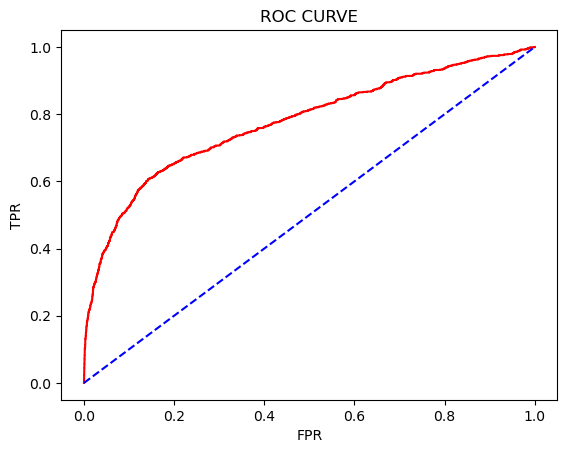

In [169]:
roc_curv(y_test,y_pred_prob)

## 7. Base Model with balanced data:

In [173]:
y.value_counts()

0    35553
1     4516
Name: y_yes, dtype: int64

In [174]:
adasyn=ADASYN()

In [176]:
X_train_bal,y_train_bal=adasyn.fit_resample(X_train,y_train)

In [177]:
X_train_c=sma.add_constant(X_train_bal)
X_test_c=sma.add_constant(X_test)

In [178]:
model=sma.Logit(y_train_bal,X_train_c).fit()

         Current function value: inf
         Iterations: 35


C:\Users\digvi\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


In [179]:
print(model.summary())

                           Logit Regression Results                           
Dep. Variable:                  y_yes   No. Observations:                56727
Model:                          Logit   Df Residuals:                    56704
Method:                           MLE   Df Model:                           22
Date:                Tue, 23 May 2023   Pseudo R-squ.:                     inf
Time:                        14:33:13   Log-Likelihood:                   -inf
converged:                      False   LL-Null:                        0.0000
Covariance Type:            nonrobust   LLR p-value:                     1.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   20.9935    451.287      0.047      0.963    -863.513     905.500
age                     -0.0402      0.011     -3.677      0.000      -0.062      -0.019
job         

C:\Users\digvi\anaconda3\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warnings.warn('Inverting hessian failed, no bse or cov_params '
C:\Users\digvi\anaconda3\lib\site-packages\statsmodels\base\model.py:592: HessianInversionWarning: Inverting hessian failed, no bse or cov_params available
  warnings.warn('Inverting hessian failed, no bse or cov_params '


In [180]:
model.aic

inf

In [183]:
y_pred_prob=model.predict(X_test_c)
y_pred_prob

27427    2.980487e-01
759      1.102993e-01
35962    3.486540e-01
34177    3.017325e-01
15445    4.475285e-01
34937    3.954773e-01
39643    9.148102e-01
22249    3.682022e-01
27642    3.810301e-01
31572    3.252799e-01
16502    2.592654e-01
35402    3.502901e-01
35488    1.606386e-01
35257    5.817225e-01
35728    5.271051e-01
18986    1.420336e-01
22719    5.064832e-01
40728    8.617310e-01
37947    8.940299e-01
8789     3.455972e-01
36776    6.700586e-01
3744     2.982683e-01
146      1.618733e-01
32701    3.763163e-01
1263     1.083341e-01
6565     2.319157e-01
10092    3.123007e-01
18155    1.977595e-01
7971     1.568579e-01
36860    6.671161e-01
15327    2.182564e-01
38669    8.442310e-01
21124    4.565718e-01
21715    3.472042e-01
33324    3.921446e-01
6576     2.929448e-01
12016    1.736456e-01
13502    4.028375e-01
24720    6.075307e-02
21824    3.854137e-01
17403    2.463347e-01
34256    3.099394e-01
32559    3.937645e-01
3787     1.247161e-01
32000    3.076146e-01
17164    2

In [185]:
y_pred=[0 if x<0.5 else 1 for x in y_pred_prob]

In [186]:
validation(y_test,y_pred)

Confusion Matrix
 [[5302 1809]
 [ 306  597]]
Accuracy 0.736086848015972
Precison 0.24812967581047382
Recall 0.6611295681063123
F1 Score 0.36083408884859475
Cohen kappa Score 0.23557744996299557
Classification Report
               precision    recall  f1-score   support

           0       0.95      0.75      0.83      7111
           1       0.25      0.66      0.36       903

    accuracy                           0.74      8014
   macro avg       0.60      0.70      0.60      8014
weighted avg       0.87      0.74      0.78      8014



AUC: 0.7674849207309562


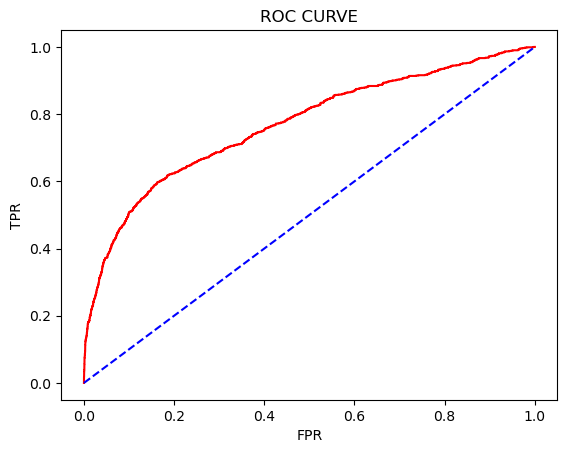

In [188]:
roc_curv(y_test,y_pred_prob)

In [189]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import StackingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB

# import the XGBoost function for classification
from xgboost import XGBClassifier

In [196]:
from sklearn.tree import DecisionTreeClassifier

## 8. Trying Other Models:

In [190]:
def model_results(model,x_train,y_train,x_test,y_test):
    print(str(model))

    model.fit(x_train,y_train)
    y_pred = model.predict(x_test)
   
    validation(y_test,y_pred)
    
    y_pred_prob = model.predict_proba(x_test)[:,1]
    
    roc_curv(y_test,y_pred_prob)

In [192]:
#1. KNN:

KNeighborsClassifier()
Confusion Matrix
 [[5354 1757]
 [ 389  514]]
Accuracy 0.7322186174195159
Precison 0.2263320123293703
Recall 0.5692137320044297
F1 Score 0.3238815374921235
Cohen kappa Score 0.1939050415256427
Classification Report
               precision    recall  f1-score   support

           0       0.93      0.75      0.83      7111
           1       0.23      0.57      0.32       903

    accuracy                           0.73      8014
   macro avg       0.58      0.66      0.58      8014
weighted avg       0.85      0.73      0.78      8014

AUC: 0.7036833112892804


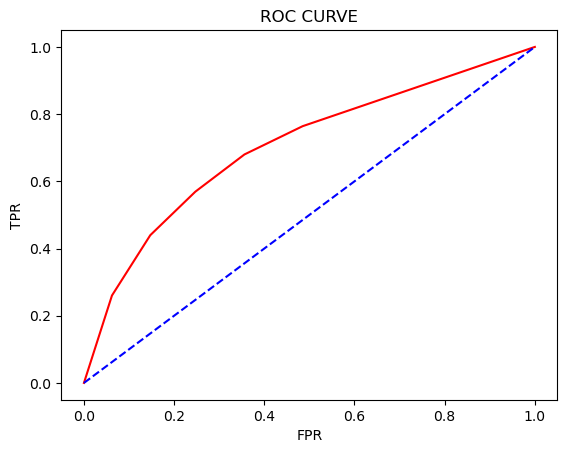

In [191]:
model_results(KNeighborsClassifier(),X_train_bal,y_train_bal,X_test,y_test)

In [193]:
#2. NB:

GaussianNB()
Confusion Matrix
 [[3943 3168]
 [ 195  708]]
Accuracy 0.580359371100574
Precison 0.1826625386996904
Recall 0.7840531561461794
F1 Score 0.2962962962962963
Cohen kappa Score 0.13891142965316616
Classification Report
               precision    recall  f1-score   support

           0       0.95      0.55      0.70      7111
           1       0.18      0.78      0.30       903

    accuracy                           0.58      8014
   macro avg       0.57      0.67      0.50      8014
weighted avg       0.87      0.58      0.66      8014

AUC: 0.763652479204539


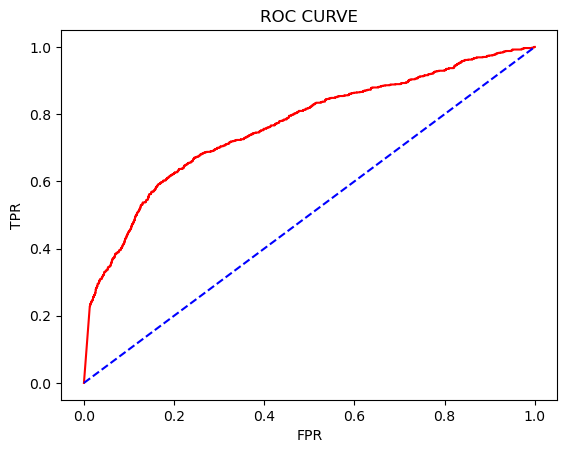

In [194]:
model_results(GaussianNB(),X_train_bal,y_train_bal,X_test,y_test)

In [195]:
#3. DT:

DecisionTreeClassifier(max_depth=7)
Confusion Matrix
 [[6508  603]
 [ 439  464]]
Accuracy 0.8699775393062141
Precison 0.43486410496719774
Recall 0.5138427464008859
F1 Score 0.47106598984771575
Cohen kappa Score 0.3975295979720326
Classification Report
               precision    recall  f1-score   support

           0       0.94      0.92      0.93      7111
           1       0.43      0.51      0.47       903

    accuracy                           0.87      8014
   macro avg       0.69      0.71      0.70      8014
weighted avg       0.88      0.87      0.87      8014

AUC: 0.7530436911415612


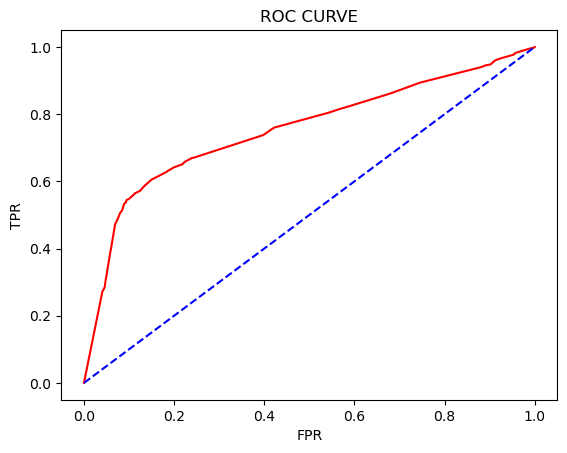

In [197]:
model_results(DecisionTreeClassifier(max_depth=7),X_train_bal,y_train_bal,X_test,y_test)

In [199]:
#4. RandomForest:

RandomForestClassifier(criterion='entropy', max_depth=10, n_estimators=200)
Confusion Matrix
 [[6414  697]
 [ 393  510]]
Accuracy 0.8639880209633142
Precison 0.4225352112676056
Recall 0.5647840531561462
F1 Score 0.4834123222748815
Cohen kappa Score 0.4069627225215344
Classification Report
               precision    recall  f1-score   support

           0       0.94      0.90      0.92      7111
           1       0.42      0.56      0.48       903

    accuracy                           0.86      8014
   macro avg       0.68      0.73      0.70      8014
weighted avg       0.88      0.86      0.87      8014

AUC: 0.7837413780188323


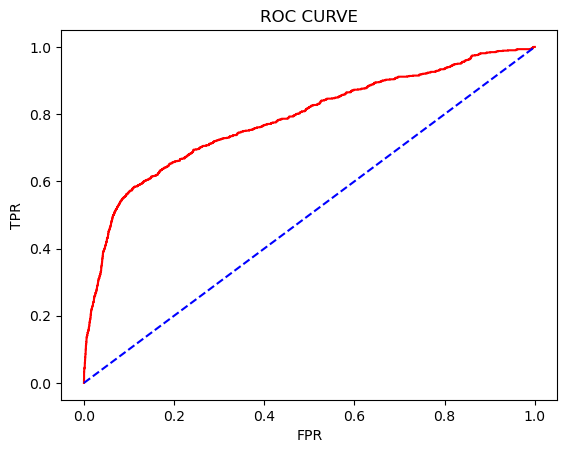

In [200]:
model_results(RandomForestClassifier(n_estimators=200,max_depth=10,criterion='entropy'),X_train_bal,y_train_bal,X_test,y_test)

In [201]:
#5. AdaBoost:

AdaBoostClassifier(learning_rate=0.2, n_estimators=500)
Confusion Matrix
 [[6589  522]
 [ 480  423]]
Accuracy 0.874968804591964
Precison 0.44761904761904764
Recall 0.4684385382059801
F1 Score 0.4577922077922078
Cohen kappa Score 0.38717055571607617
Classification Report
               precision    recall  f1-score   support

           0       0.93      0.93      0.93      7111
           1       0.45      0.47      0.46       903

    accuracy                           0.87      8014
   macro avg       0.69      0.70      0.69      8014
weighted avg       0.88      0.87      0.88      8014

AUC: 0.7727219990304042


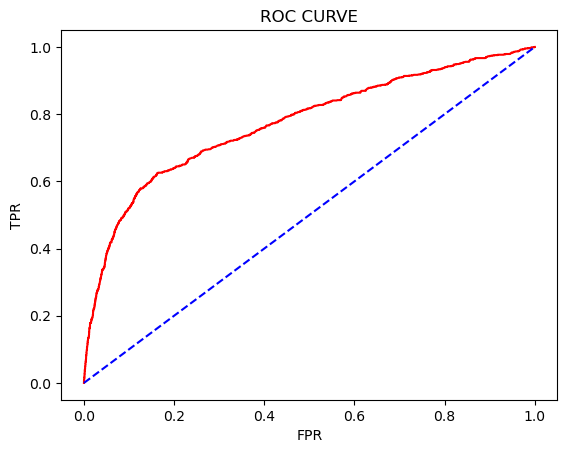

In [208]:
model_results(AdaBoostClassifier(n_estimators=500,learning_rate=0.2),X_train_bal,y_train_bal,X_test,y_test)

GradientBoostingClassifier(learning_rate=0.3, n_estimators=500)
Confusion Matrix
 [[6919  192]
 [ 609  294]]
Accuracy 0.9000499126528575
Precison 0.6049382716049383
Recall 0.32558139534883723
F1 Score 0.42332613390928725
Cohen kappa Score 0.37396303589035396
Classification Report
               precision    recall  f1-score   support

           0       0.92      0.97      0.95      7111
           1       0.60      0.33      0.42       903

    accuracy                           0.90      8014
   macro avg       0.76      0.65      0.68      8014
weighted avg       0.88      0.90      0.89      8014

AUC: 0.7879333299383467


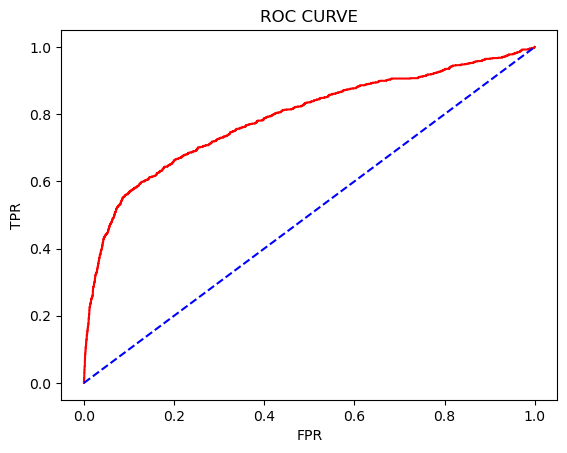

In [204]:
model_results(GradientBoostingClassifier(n_estimators=500,learning_rate=0.3),X_train_bal,y_train_bal,X_test,y_test)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=300, n_jobs=None, num_parallel_tree=None,
              predictor=None, random_state=None, ...)
Confusion Matrix
 [[6881  230]
 [ 612  291]]
Accuracy 0.8949338657349638
Precison 0.5585412667946257
Recall 0.3222591362126246
F1 Score 0.4087078651685393
Cohen kappa Score 0.35557429512530314
Classification Report
               precision    recal

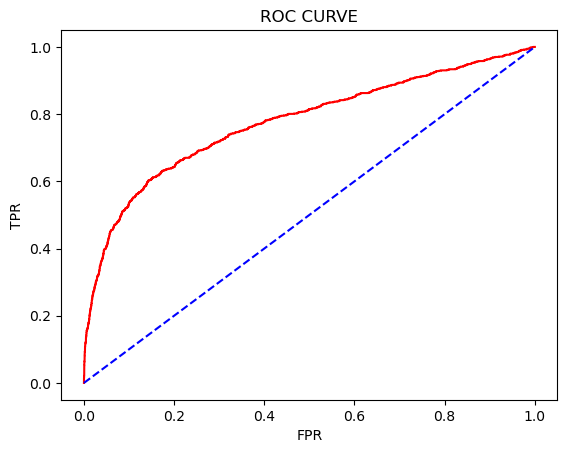

In [206]:
model_results(XGBClassifier(n_estimators=300),X_train_bal,y_train_bal,X_test,y_test)

### Let's try to improve AdaBoost:

In [209]:
grid_params={'n_estimators':[100,200,500,1000],
            'learning_rate':[0.2,0.3,0.5,0.7]}

In [210]:
grid_model=GridSearchCV(estimator=AdaBoostClassifier(),
                       param_grid=grid_params,
                       cv=3,
                       scoring='f1',
                       verbose=3)

In [211]:
grid_model.fit(X_train_bal,y_train_bal)

Fitting 3 folds for each of 16 candidates, totalling 48 fits
[CV 1/3] END learning_rate=0.2, n_estimators=100;, score=0.749 total time=   4.2s
[CV 2/3] END learning_rate=0.2, n_estimators=100;, score=0.822 total time=   3.7s
[CV 3/3] END learning_rate=0.2, n_estimators=100;, score=0.824 total time=   3.9s
[CV 1/3] END learning_rate=0.2, n_estimators=200;, score=0.758 total time=   7.9s
[CV 2/3] END learning_rate=0.2, n_estimators=200;, score=0.862 total time=   7.5s
[CV 3/3] END learning_rate=0.2, n_estimators=200;, score=0.866 total time=   7.4s
[CV 1/3] END learning_rate=0.2, n_estimators=500;, score=0.759 total time=  19.9s
[CV 2/3] END learning_rate=0.2, n_estimators=500;, score=0.902 total time=  19.6s
[CV 3/3] END learning_rate=0.2, n_estimators=500;, score=0.909 total time=  19.0s
[CV 1/3] END learning_rate=0.2, n_estimators=1000;, score=0.753 total time=  39.4s
[CV 2/3] END learning_rate=0.2, n_estimators=1000;, score=0.919 total time=  38.6s
[CV 3/3] END learning_rate=0.2, n_e

GridSearchCV(cv=3, estimator=AdaBoostClassifier(),
             param_grid={'learning_rate': [0.2, 0.3, 0.5, 0.7],
                         'n_estimators': [100, 200, 500, 1000]},
             scoring='f1', verbose=3)